# Annoration (Fine)

2024-08-28 17:01:07.217 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1591 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9-0', '9-1', '9-2', '9-3',
       '10-0', '10-1', '10-2', '11', '12', '13', '14', '15', '16-0', '16-1',
       '17-0', '17-1', '17-2', '18', '19', '20', '21', '22', '23', '24', '25',
       '26', '27', '28', '29', '30', '31'],
      dtype='object')


2024-08-28 17:01:08.995 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888


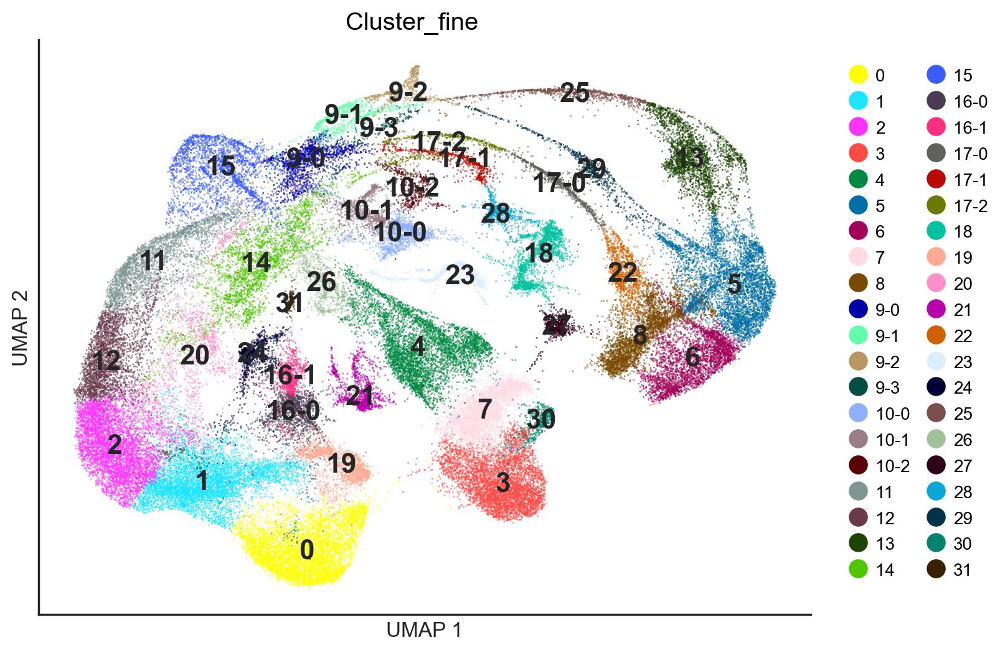

In [ ]:
ead.pl.embedding(color="Cluster_fine", size=0.2, legendCol=2, legendInFig=True, legendFigArtistKws=dict(weight="bold", fontsize=16))

In [ ]:
ead.cl.getClusterSpecGeneByCellex("Cluster_fine")

cutoff        0.60  0.70  0.80  0.90  0.95  0.99
Cluster_fine                                    
3             2001  1437   881   407   159     9
0             1985  1432   885   345   137     6
5             1949  1344   824   317   104     0
6             1931  1353   810   336   127     6
11            1674  1201   691   264    85     5
9-0           1501  1060   633   220    56     3
15            1395   948   606   299   152     0
13            1363  1020   660   308    98     0
12            1327   963   598   211    54     1
14            1270   846   463   176    76     3
2             1238   896   544   171    32     0
9-1           1083   633   363   113    28     0
25            1058   749   479   186    68     1
10-1          1027   750   500   248   110     3
19            1009   732   430   199    95    16
9-2           1004   684   459   208    84     2
29             998   706   439   162    56     1
4              997   718   458   204    86     8
1              968  

In [ ]:
dt_specGenes = ead.uns["Cluster_fine_cellexES"].query("enrichScore > 0.95").sort_values(
    "enrichScore", ascending=False
).groupby("Cluster_fine").apply(lambda x: x["gene"].tolist()).to_dict()
dt_specGenes = {x: y for x, y in dt_specGenes.items() if len(y) > 0}

In [ ]:
import sys
sys.setrecursionlimit(10000)

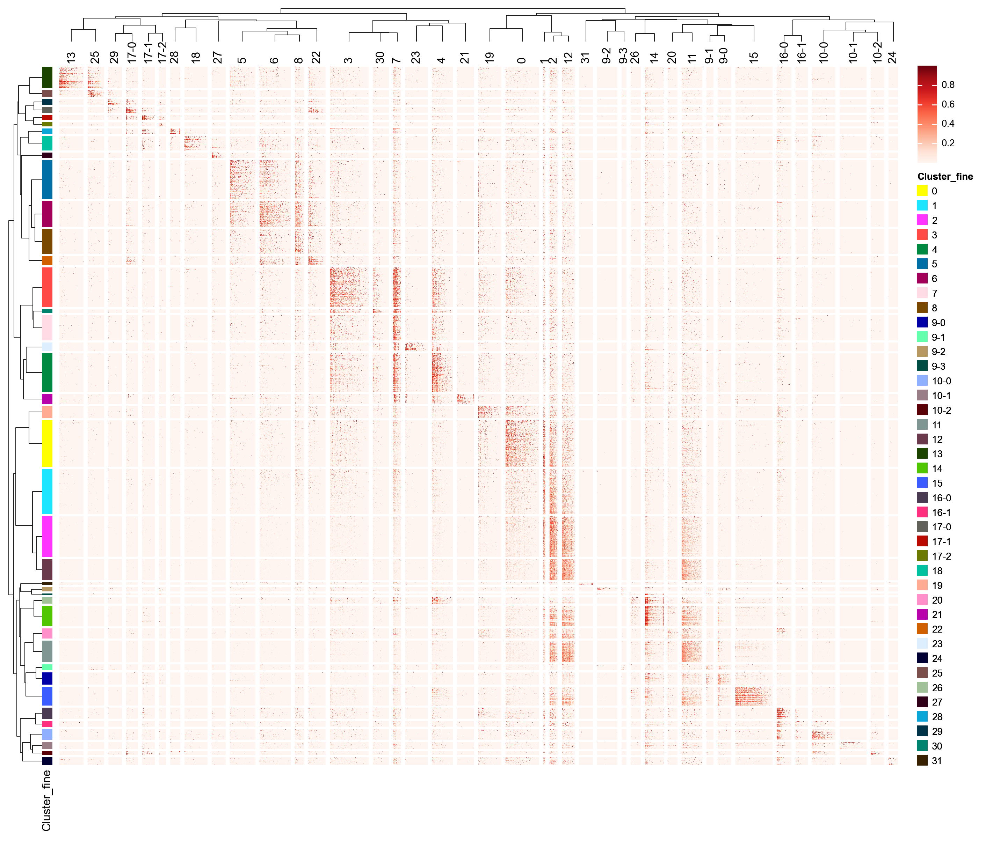

In [ ]:
h = ead.pl.heatmapGeneExp(None, ['Cluster_fine'], dt_specGenes, width=12, standardScale=0, cellSplitBy='Cluster_fine')
h.add_dendrogram('top', meta_linkage=ead.uns['dendrogram_Cluster_fine']['linkage'], add_base=False, pad=0.1)
h.add_dendrogram('left', meta_linkage=ead.uns['dendrogram_Cluster_fine']['linkage'], add_base=False)
h.render()

In [ ]:
ad_pub = sc.read_h5ad(f"/datapool/data/Users/zhijian/ipf/circadian_data/ad_pub_after_calc_sn_auc.h5ad")

In [ ]:
# ad_pub.write_h5ad(f"/datapool/data/Users/zhijian/ipf/circadian_data/ad_pub_after_calc_sn_auc.h5ad")

In [ ]:
dt_pubSpecGenes = (
    ad_pub.uns["pub_cellex_cellexES"]
    .query("enrichScore > 0.9")
    .sort_values(["celltype", "enrichScore"], ascending=[True, False])
    .groupby("celltype")["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
df_specGeneJarccard = pd.DataFrame(
    index=dt_pubSpecGenes.keys(), columns=dt_specGenes.keys()
)
for k1, v1 in dt_pubSpecGenes.items():
    for k2, v2 in dt_specGenes.items():
        df_specGeneJarccard.loc[k1, k2] = len(set(v1) & set(v2)) / len(
            set(v1) | set(v2)
        )
df_specGeneJarccard = df_specGeneJarccard.astype(float)

In [ ]:
ls_geneCat = np.where(df_specGeneJarccard.index.str.contains(":"), "Shoot", "Root")

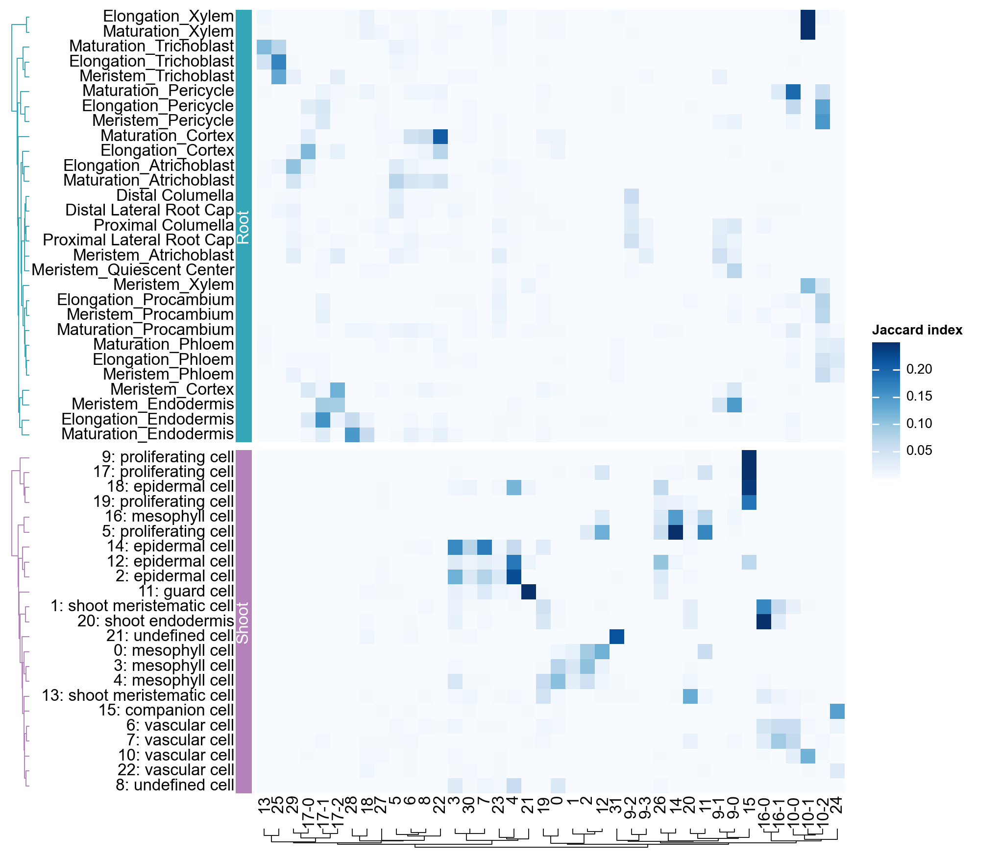

In [ ]:
g = ma.Heatmap(
    df_specGeneJarccard.values,
    cmap="Blues",
    width=6,
    height=8,
    vmax=0.25,
    label="Jaccard index",
)

g.hsplit(labels=ls_geneCat, order=["Root", "Shoot"])

g.add_left(
    ma.plotter.Chunk(
        ["Root", "Shoot"],
        fill_colors=["#33A6B8", "#B481BB"],
        color="white",
        padding=1.2,
    ),
    pad=0.05,
)
g.add_left(mp.Labels(df_specGeneJarccard.index))

g.add_dendrogram(
    "left",
    colors=["#33A6B8", "#B481BB"],
    method="ward",
    metric="euclidean",
    add_meta=False,
    size=0.2,
)
g.add_bottom(mp.Labels(df_specGeneJarccard.columns))
g.add_dendrogram("bottom", linkage=ead.uns['dendrogram_Cluster_fine']['linkage'], size=0.2)
g.add_legends(pad=-0.5)

g.render()

### pseudo-seedling spec gene AUC in circadian data

In [ ]:
ad_pub

AnnData object with n_obs × n_vars = 73286 × 23505
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'seurat_clusters', 'old.ident', 'celltype', 'tissue'
    uns: 'pub_cellex_cellexES'
    obsm: 'X_umap', 'snCircadian_AUC'
    varm: 'pub_cellex_cellexES'
    layers: 'RNA_counts', 'RNA_data', 'normalize_log', 'raw'

In [ ]:
ad_pub.obs

,orig.ident,nCount_RNA,nFeature_RNA,seurat_clusters,old.ident,celltype,tissue
TATCTGTGTATCGTTG_13,col0,5262.0,1884,22,96,Maturation_Trichoblast,Root
GATTTCTAGCCTGCCA_11,tnw1,21006.0,3540,25,14,Elongation_Cortex,Root
GAGACTTCAACCAATC_12,tnw2,24610.0,4951,9,112,Elongation_Phloem,Root
GGGTGTCAGCTGCCTG_13,col0,2410.0,1237,14,47,Elongation_Phloem,Root
CTTCTCTTCTCAGTCC_10,sc_1,65389.0,7783,7,35,Elongation_Trichoblast,Root
...,...,...,...,...,...,...,...
leaf3_TTTGTCATCCAAACAC,10X_leaf3,5985.0,2210,11,10X_leaf3,11: guard cell,Shoot
leaf3_TTTGTCATCCCTCAGT,10X_leaf3,25294.0,3537,4,10X_leaf3,4: mesophyll cell,Shoot
leaf3_TTTGTCATCCGTAGGC,10X_leaf3,9970.0,2485,0,10X_leaf3,0: mesophyll cell,Shoot
leaf3_TTTGTCATCGGAATCT,10X_leaf3,19316.0,3389,4,10X_leaf3,4: mesophyll cell,Shoot


In [ ]:
ead.addRef(ad_pub, "celltype", resultKey='pseudoSeedling')

In [ ]:
ead.anno.getAUCellScore(dt_pubSpecGenes, threads=20)

Create regulons from a dataframe of enriched features.
Additional columns saved: []


100%|██████████| 8/8 [03:29<00:00, 26.22s/it]


In [ ]:
import scipy

In [ ]:
_lkg = scipy.cluster.hierarchy.linkage(ead.obsm['AUCell'].groupby(ead.obs['Cluster_fine']).mean().T, method='complete', metric='cosine', optimal_ordering=True)

In [ ]:
1

1

2024-08-28 17:46:06.195 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:08.086 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:09.976 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:11.862 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:13.757 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888


2024-08-28 17:46:15.656 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:17.550 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:19.452 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:21.349 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:23.248 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:25.137 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:27.032 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-28 17:46:28.923 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888


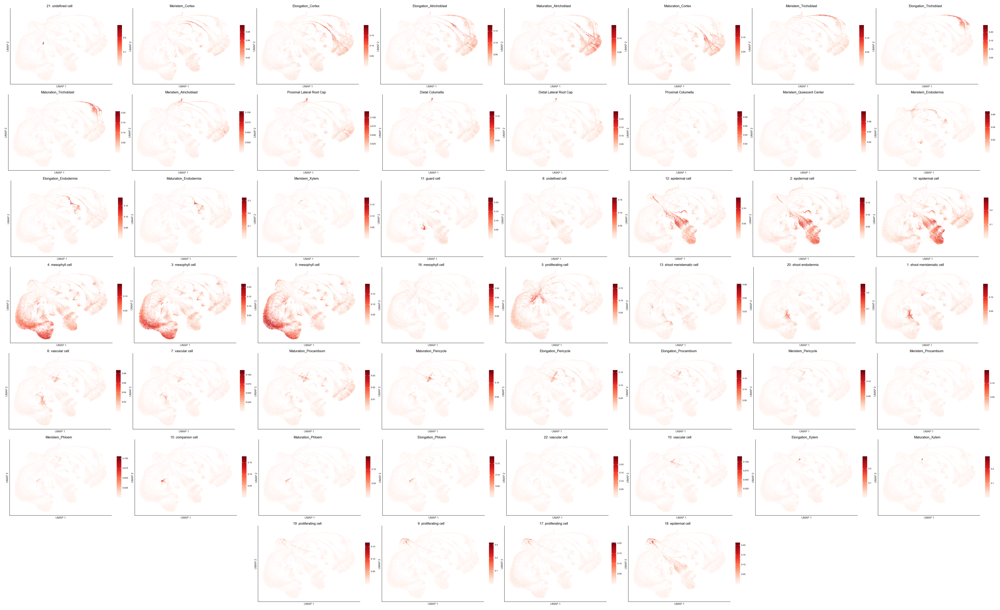

In [ ]:
ead.pl.embedding(color=ead.obsm['AUCell'].iloc[:, scipy.cluster.hierarchy.leaves_list(_lkg)].columns, colorUseObsm='AUCell', size=0.2, wrap=8).show([40, 40])

### circadian spec gene AUC in pseudoSeedling data

In [ ]:
ead_pseSdl.addRef(ead.ad, 'Cluster', resultKey='circadianSpecFine')

In [ ]:
dt_specGenesForAuc = {x:[z for z in y if z in ead_pseSdl.var.index] for x, y in dt_specGenes.items()}

In [ ]:
dt_specGenesForAuc = {x: y for x, y in dt_specGenesForAuc.items() if len(y) > 0}

In [ ]:
ead_pseSdl.anno.getAUCellScore(dt_specGenesForAuc, threads=20, label='circadianSpecFine')

Create regulons from a dataframe of enriched features.
Additional columns saved: []


  0%|          | 0/8 [00:00<?, ?it/s]

100%|██████████| 8/8 [03:15<00:00, 24.44s/it]


2024-08-28 17:51:19.932 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.9844444444444445
2024-08-28 17:51:21.764 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.9844444444444445
2024-08-28 17:51:23.596 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.9844444444444445
2024-08-28 17:51:25.437 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.9844444444444445
2024-08-28 17:51:27.281 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.9844444444444445
2024-08-28 17:51:29.146 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.9844444444444445
2024-08-28 17:51:31.035 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.9844444444444445
2024-08-28 17:51:32.877 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.9844444444444445


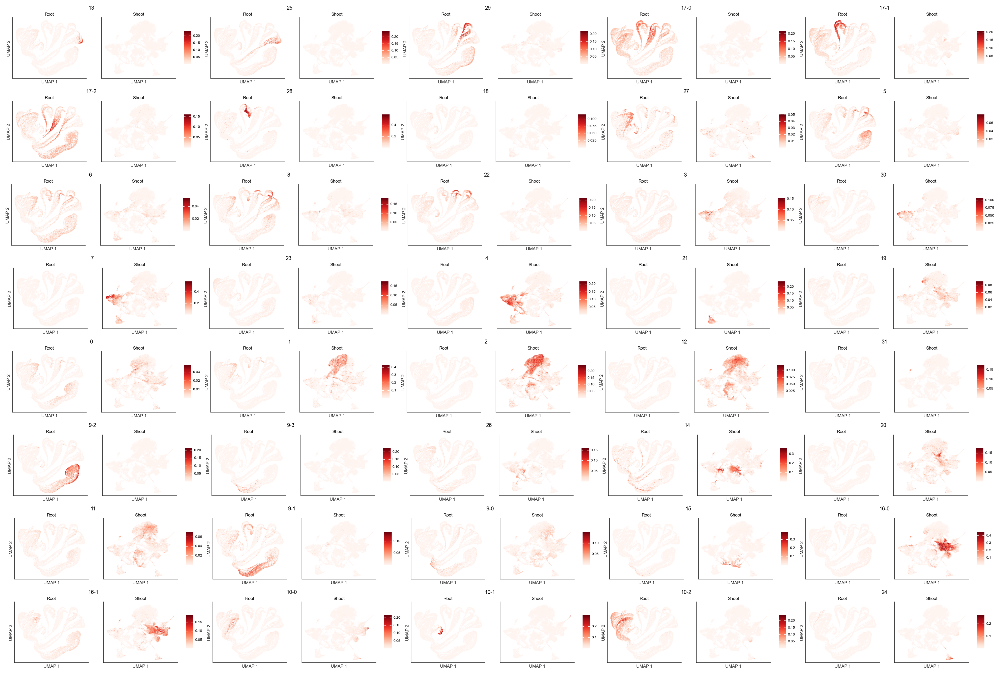

In [ ]:
ead_pseSdl.pl.embedding(color=ead.uns['dendrogram_Cluster_fine']['categories_ordered'], groupby='tissue', colorUseObsm='circadianSpecFine', size=0.2, wrap=5, figsize=(8, 3)).show([40, 40])